In [1]:
!nvidia-smi

Wed May 24 09:08:49 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   40C    P8     9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [2]:
import os
HOME = os.getcwd()
print(HOME)

/content


In [3]:
!pip install -i https://test.pypi.org/simple/ supervision==0.3.0
!pip install -q transformers
!pip install -q pytorch-lightning
!pip install -q roboflow
!pip install -q timm

Looking in indexes: https://test.pypi.org/simple/, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.1/7.1 MB 90.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.5/224.5 kB 19.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 41.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 719.0/719.0 kB 36.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 519.2/519.2 kB 36.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 66.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 114.5/114.5 kB 16.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 33.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 149.6/149.6 kB 20.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 kB 5.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 4.3 MB/s eta 0:00:00
     ━━━━━━━

In [4]:
import torch
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)

import roboflow
import supervision
import transformers
import pytorch_lightning

print(
    "roboflow:", roboflow.__version__, 
    "; supervision:", supervision.__version__, 
    "; transformers:", transformers.__version__, 
    "; pytorch_lightning:", pytorch_lightning.__version__
)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:33:58_PDT_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0
torch:  2.0 ; cuda:  cu118
roboflow: 1.0.9 ; supervision: 0.3.0 ; transformers: 4.29.2 ; pytorch_lightning: 2.0.2


In [6]:
import torch
from transformers import DetrForObjectDetection, DetrImageProcessor


# settings
DEVICE = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
CHECKPOINT = 'facebook/detr-resnet-50'
CONFIDENCE_TRESHOLD = 0.5
IOU_TRESHOLD = 0.8

image_processor = DetrImageProcessor.from_pretrained(CHECKPOINT)
model = DetrForObjectDetection.from_pretrained(CHECKPOINT)
model.to(DEVICE)

DetrForObjectDetection(
  (model): DetrModel(
    (backbone): DetrConvModel(
      (conv_encoder): DetrConvEncoder(
        (model): FeatureListNet(
          (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
          (bn1): DetrFrozenBatchNorm2d()
          (act1): ReLU(inplace=True)
          (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
          (layer1): Sequential(
            (0): Bottleneck(
              (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
              (bn1): DetrFrozenBatchNorm2d()
              (act1): ReLU(inplace=True)
              (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
              (bn2): DetrFrozenBatchNorm2d()
              (drop_block): Identity()
              (act2): ReLU(inplace=True)
              (aa): Identity()
              (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      

In [8]:
!unzip -q 'trash detector.v3i.coco.zip'

In [9]:
import os
import torchvision

# settings
ANNOTATION_FILE_NAME = "_annotations.coco.json"
TRAIN_DIRECTORY = '/content/train'
VAL_DIRECTORY = '/content/valid'
TEST_DIRECTORY = '/content/test'

class CocoDetection(torchvision.datasets.CocoDetection):
    def __init__(
        self, 
        image_directory_path: str, 
        image_processor, 
        train: bool = True
    ):
        annotation_file_path = os.path.join(image_directory_path, ANNOTATION_FILE_NAME)
        super(CocoDetection, self).__init__(image_directory_path, annotation_file_path)
        self.image_processor = image_processor

    def __getitem__(self, idx):
        images, annotations = super(CocoDetection, self).__getitem__(idx)        
        image_id = self.ids[idx]
        annotations = {'image_id': image_id, 'annotations': annotations}
        encoding = self.image_processor(images=images, annotations=annotations, return_tensors="pt")
        pixel_values = encoding["pixel_values"].squeeze()
        target = encoding["labels"][0]

        return pixel_values, target


TRAIN_DATASET = CocoDetection(
    image_directory_path=TRAIN_DIRECTORY, 
    image_processor=image_processor, 
    train=True)
VAL_DATASET = CocoDetection(
    image_directory_path=VAL_DIRECTORY, 
    image_processor=image_processor, 
    train=False)
TEST_DATASET = CocoDetection(
    image_directory_path=TEST_DIRECTORY, 
    image_processor=image_processor, 
    train=False)

print("Number of training examples:", len(TRAIN_DATASET))
print("Number of validation examples:", len(VAL_DATASET))
print("Number of test examples:", len(TEST_DATASET))

loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Number of training examples: 152
Number of validation examples: 45
Number of test examples: 50


In [10]:
import random
import cv2
import numpy as np

# select random image
image_ids = TRAIN_DATASET.coco.getImgIds()
image_id = random.choice(image_ids)
print('Image #{}'.format(image_id))

Image #57


In [11]:
# load image and annotatons 
image = TRAIN_DATASET.coco.loadImgs(image_id)[0]
annotations = TRAIN_DATASET.coco.imgToAnns[image_id]
image_path = os.path.join(TRAIN_DATASET.root, image['file_name'])
image = cv2.imread(image_path)

In [13]:
import supervision as sv


In [14]:
# annotate
detections = sv.Detections.from_coco_annotations(coco_annotation=annotations)

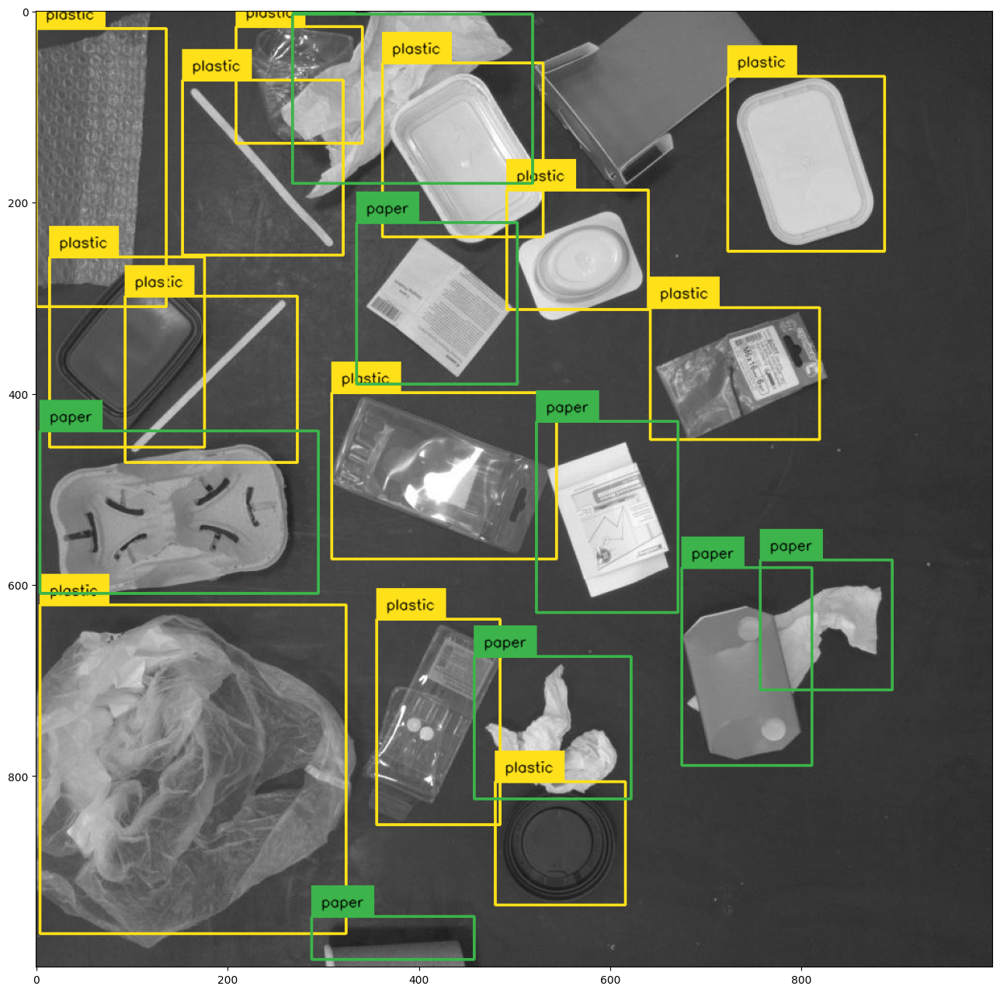

In [15]:
# we will use id2label function for training
categories = TRAIN_DATASET.coco.cats
id2label = {k: v['name'] for k,v in categories.items()}

labels = [
    f"{id2label[class_id]}" 
    for _, _, class_id, _ 
    in detections
]

box_annotator = sv.BoxAnnotator()
frame = box_annotator.annotate(scene=image, detections=detections, labels=labels)

%matplotlib inline  
sv.show_frame_in_notebook(image, (16, 16))

In [16]:
from torch.utils.data import DataLoader

def collate_fn(batch):
    # DETR authors employ various image sizes during training, making it not possible 
    # to directly batch together images. Hence they pad the images to the biggest 
    # resolution in a given batch, and create a corresponding binary pixel_mask 
    # which indicates which pixels are real/which are padding
    pixel_values = [item[0] for item in batch]
    encoding = image_processor.pad(pixel_values, return_tensors="pt")
    labels = [item[1] for item in batch]
    return {
        'pixel_values': encoding['pixel_values'],
        'pixel_mask': encoding['pixel_mask'],
        'labels': labels
    }

TRAIN_DATALOADER = DataLoader(dataset=TRAIN_DATASET, collate_fn=collate_fn, batch_size=4, shuffle=True)
VAL_DATALOADER = DataLoader(dataset=VAL_DATASET, collate_fn=collate_fn, batch_size=4)
TEST_DATALOADER = DataLoader(dataset=TEST_DATASET, collate_fn=collate_fn, batch_size=4)

In [17]:
import pytorch_lightning as pl
from transformers import DetrForObjectDetection
import torch


class Detr(pl.LightningModule):

    def __init__(self, lr, lr_backbone, weight_decay):
        super().__init__()
        self.model = DetrForObjectDetection.from_pretrained(
            pretrained_model_name_or_path=CHECKPOINT, 
            num_labels=len(id2label),
            ignore_mismatched_sizes=True
        )
        
        self.lr = lr
        self.lr_backbone = lr_backbone
        self.weight_decay = weight_decay

    def forward(self, pixel_values, pixel_mask):
        return self.model(pixel_values=pixel_values, pixel_mask=pixel_mask)

    def common_step(self, batch, batch_idx):
        pixel_values = batch["pixel_values"]
        pixel_mask = batch["pixel_mask"]
        labels = [{k: v.to(self.device) for k, v in t.items()} for t in batch["labels"]]

        outputs = self.model(pixel_values=pixel_values, pixel_mask=pixel_mask, labels=labels)

        loss = outputs.loss
        loss_dict = outputs.loss_dict

        return loss, loss_dict

    def training_step(self, batch, batch_idx):
        loss, loss_dict = self.common_step(batch, batch_idx)     
        # logs metrics for each training_step, and the average across the epoch
        self.log("training_loss", loss)
        for k,v in loss_dict.items():
            self.log("train_" + k, v.item())

        return loss

    def validation_step(self, batch, batch_idx):
        loss, loss_dict = self.common_step(batch, batch_idx)     
        self.log("validation/loss", loss)
        for k, v in loss_dict.items():
            self.log("validation_" + k, v.item())
            
        return loss

    def configure_optimizers(self):
        # DETR authors decided to use different learning rate for backbone
        # you can learn more about it here: 
        # - https://github.com/facebookresearch/detr/blob/3af9fa878e73b6894ce3596450a8d9b89d918ca9/main.py#L22-L23
        # - https://github.com/facebookresearch/detr/blob/3af9fa878e73b6894ce3596450a8d9b89d918ca9/main.py#L131-L139
        param_dicts = [
            {
                "params": [p for n, p in self.named_parameters() if "backbone" not in n and p.requires_grad]},
            {
                "params": [p for n, p in self.named_parameters() if "backbone" in n and p.requires_grad],
                "lr": self.lr_backbone,
            },
        ]
        return torch.optim.AdamW(param_dicts, lr=self.lr, weight_decay=self.weight_decay)

    def train_dataloader(self):
        return TRAIN_DATALOADER

    def val_dataloader(self):
        return VAL_DATALOADER

In [18]:
%cd {HOME}

%load_ext tensorboard
%tensorboard --logdir lightning_logs/

/content


<IPython.core.display.Javascript object>

In [19]:
model = Detr(lr=1e-4, lr_backbone=1e-5, weight_decay=1e-4)

batch = next(iter(TRAIN_DATALOADER))
outputs = model(pixel_values=batch['pixel_values'], pixel_mask=batch['pixel_mask'])

Some weights of DetrForObjectDetection were not initialized from the model checkpoint at facebook/detr-resnet-50 and are newly initialized because the shapes did not match:
- class_labels_classifier.weight: found shape torch.Size([92, 256]) in the checkpoint and torch.Size([4, 256]) in the model instantiated
- class_labels_classifier.bias: found shape torch.Size([92]) in the checkpoint and torch.Size([4]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [20]:
outputs.logits.shape

torch.Size([4, 100, 4])

In [21]:
id2labelfrom pytorch_lightning import Trainer

%cd {HOME}

# settings
MAX_EPOCHS = 50

# pytorch_lightning < 2.0.0
# trainer = Trainer(gpus=1, max_epochs=MAX_EPOCHS, gradient_clip_val=0.1, accumulate_grad_batches=8, log_every_n_steps=5)

# pytorch_lightning >= 2.0.0
trainer = Trainer(devices=1, accelerator="gpu", max_epochs=MAX_EPOCHS, gradient_clip_val=0.1, accumulate_grad_batches=8, log_every_n_steps=5)

trainer.fit(model)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


/content


INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                   | Params
-------------------------------------------------
0 | model | DetrForObjectDetection | 41.5 M
-------------------------------------------------
41.3 M    Trainable params
222 K     Non-trainable params
41.5 M    Total params
166.039   Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Trying to infer the `batch_size` from an ambiguous collection. The batch size we found is 4. To avoid any miscalculations, use `self.log(..., batch_size=batch_size)`.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Trying to infer the `batch_size` from an ambiguous collection. The batch size we found is 1. To avoid any miscalculations, use `self.log(..., batch_size=batch_size)`.


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=50` reached.


## Inference on test dataset

Let's visualize the predictions of DETR on the first image of the validation set.

In [26]:
model.to(DEVICE)

Detr(
  (model): DetrForObjectDetection(
    (model): DetrModel(
      (backbone): DetrConvModel(
        (conv_encoder): DetrConvEncoder(
          (model): FeatureListNet(
            (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
            (bn1): DetrFrozenBatchNorm2d()
            (act1): ReLU(inplace=True)
            (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
            (layer1): Sequential(
              (0): Bottleneck(
                (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
                (bn1): DetrFrozenBatchNorm2d()
                (act1): ReLU(inplace=True)
                (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
                (bn2): DetrFrozenBatchNorm2d()
                (drop_block): Identity()
                (act2): ReLU(inplace=True)
                (aa): Identity()
                (conv3): Conv2d(64, 256

In [29]:
import random
import cv2
import numpy as np

#utils
categories = TEST_DATASET.coco.cats
id2label = {k: v['name'] for k,v in categories.items()}
box_annotator = sv.BoxAnnotator()

In [37]:
# select random image
image_ids = TEST_DATASET.coco.getImgIds()
image_id = random.choice(image_ids)
print('Image #{}'.format(image_id))

Image #36


In [39]:
# load image and annotatons 
image = TEST_DATASET.coco.loadImgs(image_id)[0]
annotations = TEST_DATASET.coco.imgToAnns[image_id]
image_path = os.path.join(TEST_DATASET.root, image['file_name'])
image = cv2.imread(image_path)

In [44]:
# annotate
detections = sv.Detections.from_coco_annotations(coco_annotation=annotations)
labels = [f'{id2label[class_id]}' for _,_, class_id, _ in detections]
frame = box_annotator.annotate(scene=image.copy(), detections=detections, labels=labels)

ground truth


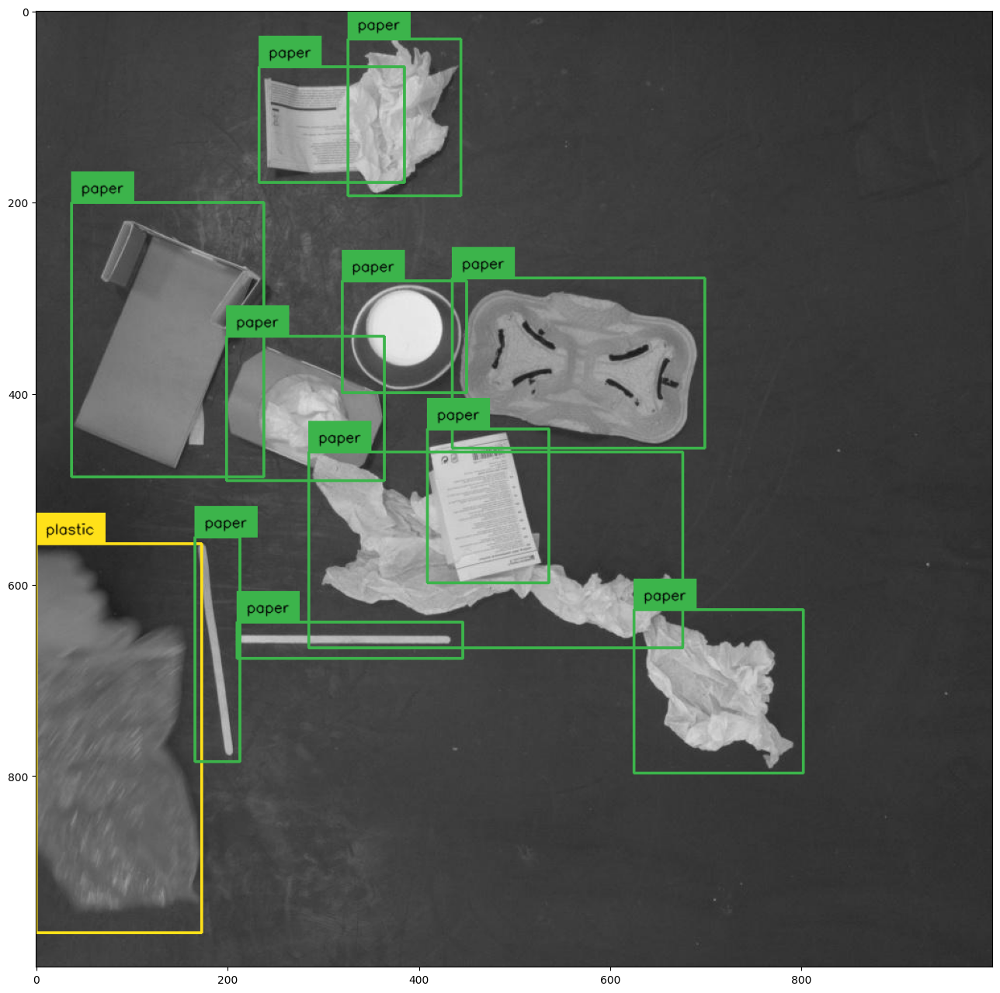

In [49]:
print('ground truth')
%matplotlib inline  
sv.show_frame_in_notebook(frame, (16, 16))

time 0.2575399875640869
detections


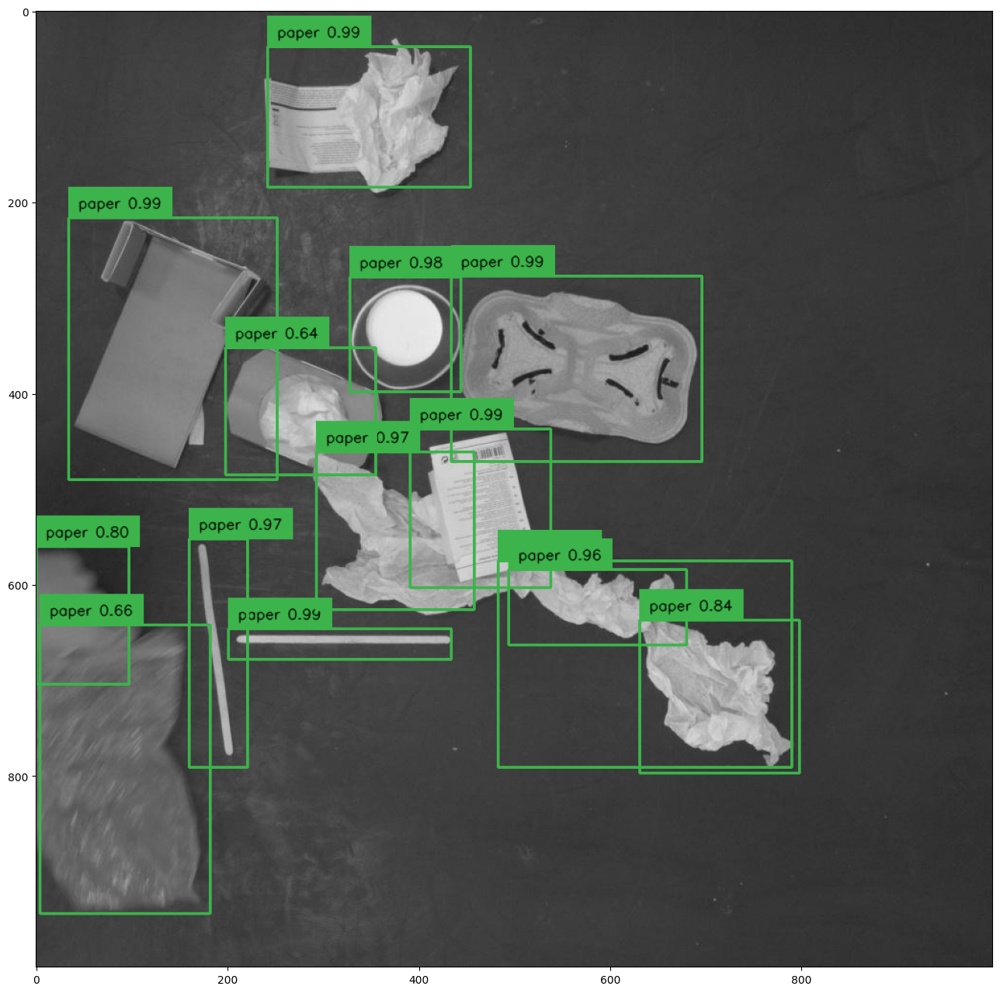

In [56]:
import time
# inference
with torch.no_grad():

  #load image and predict
  time_start = time.time()
  inputs = image_processor(images=image, return_tensors = 'pt').to(DEVICE)
  outputs = model(**inputs)
  time_end = time.time()

  #post-process
  target_sizes = torch.tensor([image.shape[:2]]).to(DEVICE)
  results = image_processor.post_process_object_detection(
      outputs = outputs,
      threshold = CONFIDENCE_TRESHOLD,
      target_sizes=target_sizes
  )[0]

# annotate
detections = sv.Detections.from_transformers(transformers_results=results).with_nms(threshold=0.5)
labels = [f"{id2label[class_id]} {confidence:.2f}" for _, confidence, class_id, _ in detections]
frame = box_annotator.annotate(scene=image.copy(), detections=detections, labels=labels)
print('time', time_end-time_start)
print('detections')
%matplotlib inline  
sv.show_frame_in_notebook(frame, (16, 16))

## Evaluation on test dataset

Finally, we evaluate the model on the `TEST_DATASET`. For this we make use of the `CocoEvaluator` class available in a tiny [PyPi package](https://github.com/NielsRogge/coco-eval) made by [Niels Rogge](https://github.com/NielsRogge) . This class is entirely based on the [original evaluator](https://github.com/facebookresearch/detr/blob/main/datasets/coco_eval.py) class used by the DETR authors.

In [52]:
! pip install -q coco_eval

  Preparing metadata (setup.py) ... done


In [54]:
def convert_to_xywh(boxes):
  xmin,ymin, xmax, ymax = boxes.unbind(1)
  return torch.stack((xmin, ymin, xmax - xmin, ymax - ymin), dim = 1)

In [61]:
def prepare_for_coco_detection(predictions):
  coco_results = []
  for original_id, prediction in predictions.items():
    if len(prediction) == 0:
      continue
    
    boxes = prediction['boxes']
    boxes = convert_to_xywh(boxes).tolist()
    scores = prediction['scores'].tolist()
    labels = prediction['labels'].tolist()

    coco_results.extend(
        [
            {
              'image_id': original_id,
              'category_id': labels[k],
              'bbox': box,
              'score': scores[k],
            }
         for k, box in enumerate(boxes)
        ]
    )
  return coco_results

In [62]:
from coco_eval import CocoEvaluator
from tqdm.notebook import tqdm

import numpy as np

evaluator = CocoEvaluator(coco_gt=TEST_DATASET.coco, iou_types=['bbox'])

print("Running evaluation...")

for idx, batch in enumerate(tqdm(TEST_DATALOADER)):
  pixel_values = batch['pixel_values'].to(DEVICE)
  pixel_mask = batch['pixel_mask'].to(DEVICE)
  labels = [{k: v.to(DEVICE) for k, v in t.items()} for t in batch["labels"]]

  with torch.no_grad():
    outputs = model(pixel_values=pixel_values, pixel_mask=pixel_mask)

  orig_target_sizes = torch.stack([target['orig_size'] for target in labels], dim = 0)
  results = image_processor.post_process_object_detection(outputs, target_sizes=orig_target_sizes)

  predictions = {target['image_id'].item(): outputs for target, outputs in zip(labels, results)}
  predictions = prepare_for_coco_detection(predictions)
  evaluator.update(predictions)

evaluator.synchronize_between_processes()
evaluator.accumulate()
evaluator.summarize()

Running evaluation...


  0%|          | 0/13 [00:00<?, ?it/s]

Accumulating evaluation results...
DONE (t=0.03s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.520
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.841
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.618
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.366
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.532
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.145
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.595
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.618
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.508
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= 

In [63]:
MODEL_PATH = os.path.join(HOME, 'custom-model')

In [65]:
model.model.save_pretrained(MODEL_PATH)

## YOLO-NAS

In [2]:
!unzip -q 'Trash Detection.v1i.yolov5pytorch.zip'

## Install YOLO-NAS

In [3]:
!pip install -q super-gradients==3.1.1
!pip install -q roboflow
!pip install -q supervision

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 964.2/964.2 kB 57.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 887.5/887.5 MB 1.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.6/135.6 kB 16.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 684.5/684.5 kB 55.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 52.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.8/2.8 MB 106.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 408.6/408.6 kB 34.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 75.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 19.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 9.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 106.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.5/13.5 MB 87.7 MB/s eta 0:

In [1]:
import os
HOME = os.getcwd()
print(HOME)

/content


In [2]:
import torch

DEVICE = 'cuda' if torch.cuda.is_available() else "cpu"
MODEL_ARCH = 'yolo_nas_l'
BATCH_SIZE = 8
MAX_EPOCHS = 25
CHECKPOINT_DIR = f'{HOME}/checkpoints'
EXPERIMENT_NAME = 'Trash detection yolo-nas'

In [3]:
from super_gradients.training import Trainer

trainer = Trainer(experiment_name=EXPERIMENT_NAME, ckpt_root_dir=CHECKPOINT_DIR)

[2023-05-24 13:52:11] INFO - crash_tips_setup.py - Crash tips is enabled. You can set your environment variable to CRASH_HANDLER=FALSE to disable it


The console stream is logged into /root/sg_logs/console.log


/usr/local/lib/python3.10/dist-packages/_distutils_hack/__init__.py:33: UserWarning: Setuptools is replacing distutils.
  warnings.warn("Setuptools is replacing distutils.")
[2023-05-24 13:52:18] WARNING - __init__.py - Failed to import pytorch_quantization
[2023-05-24 13:52:18] WARNING - calibrator.py - Failed to import pytorch_quantization
[2023-05-24 13:52:18] WARNING - export.py - Failed to import pytorch_quantization
[2023-05-24 13:52:18] WARNING - selective_quantization_utils.py - Failed to import pytorch_quantization


In [5]:
LOCATION = '/content/'
CLASSES = ['paper', 'plastic']

In [6]:
dataset_params = {
    'data_dir': LOCATION,
    'train_images_dir':'train/images',
    'train_labels_dir':'train/labels',
    'val_images_dir':'valid/images',
    'val_labels_dir':'valid/labels',
    'test_images_dir':'test/images',
    'test_labels_dir':'test/labels',
    'classes': CLASSES
}

In [9]:
from super_gradients.training.dataloaders.dataloaders import (
    coco_detection_yolo_format_train, coco_detection_yolo_format_val)

train_data = coco_detection_yolo_format_train(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['train_images_dir'],
        'labels_dir': dataset_params['train_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size': BATCH_SIZE,
        'num_workers': 2
    }
)

val_data = coco_detection_yolo_format_val(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['val_images_dir'],
        'labels_dir': dataset_params['val_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size': BATCH_SIZE,
        'num_workers': 2
    }
)

test_data = coco_detection_yolo_format_val(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['test_images_dir'],
        'labels_dir': dataset_params['test_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size': BATCH_SIZE,
        'num_workers': 2
    }
)

Caching annotations: 100%|██████████| 45/45 [00:00<00:00, 4599.02it/s]


In [12]:
train_data.dataset.transforms

[DetectionMosaic('additional_samples_count': 3, 'non_empty_targets': False, 'prob': 1.0, 'input_dim': [640, 640], 'enable_mosaic': True, 'border_value': 114),
 DetectionRandomAffine('additional_samples_count': 0, 'non_empty_targets': False, 'degrees': 10.0, 'translate': 0.1, 'scale': [0.1, 2], 'shear': 2.0, 'target_size': [640, 640], 'enable': True, 'filter_box_candidates': True, 'wh_thr': 2, 'ar_thr': 20, 'area_thr': 0.1, 'border_value': 114),
 DetectionMixup('additional_samples_count': 1, 'non_empty_targets': True, 'input_dim': [640, 640], 'mixup_scale': [0.5, 1.5], 'prob': 1.0, 'enable_mixup': True, 'flip_prob': 0.5, 'border_value': 114),
 DetectionHSV('additional_samples_count': 0, 'non_empty_targets': False, 'prob': 1.0, 'hgain': 5, 'sgain': 30, 'vgain': 30, 'bgr_channels': (0, 1, 2), '_additional_channels_warned': False),
 DetectionHorizontalFlip('additional_samples_count': 0, 'non_empty_targets': False, 'prob': 0.5, 'max_targets': 120),
 DetectionPaddedRescale('swap': (2, 0, 1),

In [13]:
from super_gradients.training import models

model = models.get(
    MODEL_ARCH, 
    num_classes=len(dataset_params['classes']), 
    pretrained_weights="coco"
)

[2023-05-24 13:57:13] INFO - checkpoint_utils.py - License Notification: YOLO-NAS pre-trained weights are subjected to the specific license terms and conditions detailed in 
https://github.com/Deci-AI/super-gradients/blob/master/LICENSE.YOLONAS.md
By downloading the pre-trained weight files you agree to comply with these terms.


  0%|          | 0.00/256M [00:00<?, ?B/s]

Downloading: "https://sghub.deci.ai/models/yolo_nas_l_coco.pth" to /root/.cache/torch/hub/checkpoints/yolo_nas_l_coco.pth


In [14]:
from super_gradients.training.losses import PPYoloELoss
from super_gradients.training.metrics import DetectionMetrics_050
from super_gradients.training.models.detection_models.pp_yolo_e import PPYoloEPostPredictionCallback

train_params = {
    'silent_mode': False,
    "average_best_models":True,
    "warmup_mode": "linear_epoch_step",
    "warmup_initial_lr": 1e-6,
    "lr_warmup_epochs": 3,
    "initial_lr": 5e-4,
    "lr_mode": "cosine",
    "cosine_final_lr_ratio": 0.1,
    "optimizer": "Adam",
    "optimizer_params": {"weight_decay": 0.0001},
    "zero_weight_decay_on_bias_and_bn": True,
    "ema": True,
    "ema_params": {"decay": 0.9, "decay_type": "threshold"},
    "max_epochs": MAX_EPOCHS,
    "mixed_precision": True,
    "loss": PPYoloELoss(
        use_static_assigner=False,
        num_classes=len(dataset_params['classes']),
        reg_max=16
    ),
    "valid_metrics_list": [
        DetectionMetrics_050(
            score_thres=0.1,
            top_k_predictions=300,
            num_cls=len(dataset_params['classes']),
            normalize_targets=True,
            post_prediction_callback=PPYoloEPostPredictionCallback(
                score_threshold=0.01,
                nms_top_k=1000,
                max_predictions=300,
                nms_threshold=0.7
            )
        )
    ],
    "metric_to_watch": 'mAP@0.50'
}

In [15]:
trainer.train(
    model=model, 
    training_params=train_params, 
    train_loader=train_data, 
    valid_loader=val_data
)

[2023-05-24 13:57:57] INFO - sg_trainer.py - Using EMA with params {'decay': 0.9, 'decay_type': 'threshold'}
[2023-05-24 13:58:04] INFO - utils.py - NumExpr defaulting to 2 threads.


The console stream is now moved to /content/checkpoints/Trash detection yolo-nas/console_May24_13_58_05.txt


[2023-05-24 13:58:12] INFO - sg_trainer_utils.py - TRAINING PARAMETERS:
    - Mode:                         Single GPU
    - Number of GPUs:               1          (1 available on the machine)
    - Dataset size:                 152        (len(train_set))
    - Batch size per GPU:           8          (batch_size)
    - Batch Accumulate:             1          (batch_accumulate)
    - Total batch size:             8          (num_gpus * batch_size)
    - Effective Batch size:         8          (num_gpus * batch_size * batch_accumulate)
    - Iterations per epoch:         19         (len(train_loader))
    - Gradient updates per epoch:   19         (len(train_loader) / batch_accumulate)

[2023-05-24 13:58:12] INFO - sg_trainer.py - Started training for 25 epochs (0/24)

Validation epoch 0: 100%|██████████| 6/6 [00:02<00:00,  2.02it/s]


SUMMARY OF EPOCH 0
├── Training
│   ├── Ppyoloeloss/loss = 3.6212
│   ├── Ppyoloeloss/loss_cls = 2.2711
│   ├── Ppyoloeloss/loss_dfl = 1.4342
│   └── Ppyoloeloss/loss_iou = 0.2532
└── Validation
    ├── F1@0.50 = 0.0
    ├── Map@0.50 = 0.0
    ├── Ppyoloeloss/loss = 3.6803
    ├── Ppyoloeloss/loss_cls = 2.5933
    ├── Ppyoloeloss/loss_dfl = 1.2578
    ├── Ppyoloeloss/loss_iou = 0.1832
    ├── Precision@0.50 = 0.0
    └── Recall@0.50 = 0.0



[2023-05-24 13:58:50] INFO - base_sg_logger.py - Checkpoint saved in /content/checkpoints/Trash detection yolo-nas/ckpt_best.pth
[2023-05-24 13:58:50] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.0
Validation epoch 1: 100%|██████████| 6/6 [00:03<00:00,  1.88it/s]


SUMMARY OF EPOCH 1
├── Training
│   ├── Ppyoloeloss/loss = 2.5422
│   │   ├── Best until now = 3.6212 (↘ -1.079)
│   │   └── Epoch N-1      = 3.6212 (↘ -1.079)
│   ├── Ppyoloeloss/loss_cls = 1.3152
│   │   ├── Best until now = 2.2711 (↘ -0.9559)
│   │   └── Epoch N-1      = 2.2711 (↘ -0.9559)
│   ├── Ppyoloeloss/loss_dfl = 1.3099
│   │   ├── Best until now = 1.4342 (↘ -0.1243)
│   │   └── Epoch N-1      = 1.4342 (↘ -0.1243)
│   └── Ppyoloeloss/loss_iou = 0.2288
│       ├── Best until now = 0.2532 (↘ -0.0244)
│       └── Epoch N-1      = 0.2532 (↘ -0.0244)
└── Validation
    ├── F1@0.50 = 0.1856
    │   ├── Best until now = 0.0    (↗ 0.1856)
    │   └── Epoch N-1      = 0.0    (↗ 0.1856)
    ├── Map@0.50 = 0.608
    │   ├── Best until now = 0.0    (↗ 0.608)
    │   └── Epoch N-1      = 0.0    (↗ 0.608)
    ├── Ppyoloeloss/loss = 10.5422
    │   ├── Best until now = 3.6803 (↗ 6.862)
    │   └── Epoch N-1      = 3.6803 (↗ 6.862)
    ├── Ppyoloeloss/loss_cls = 9.4849
    │   ├── Best until

[2023-05-24 13:59:29] INFO - base_sg_logger.py - Checkpoint saved in /content/checkpoints/Trash detection yolo-nas/ckpt_best.pth
[2023-05-24 13:59:29] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.6079590916633606
Validation epoch 2: 100%|██████████| 6/6 [00:03<00:00,  1.75it/s]


SUMMARY OF EPOCH 2
├── Training
│   ├── Ppyoloeloss/loss = 2.0295
│   │   ├── Best until now = 2.5422 (↘ -0.5127)
│   │   └── Epoch N-1      = 2.5422 (↘ -0.5127)
│   ├── Ppyoloeloss/loss_cls = 0.8986
│   │   ├── Best until now = 1.3152 (↘ -0.4166)
│   │   └── Epoch N-1      = 1.3152 (↘ -0.4166)
│   ├── Ppyoloeloss/loss_dfl = 1.2197
│   │   ├── Best until now = 1.3099 (↘ -0.0902)
│   │   └── Epoch N-1      = 1.3099 (↘ -0.0902)
│   └── Ppyoloeloss/loss_iou = 0.2084
│       ├── Best until now = 0.2288 (↘ -0.0204)
│       └── Epoch N-1      = 0.2288 (↘ -0.0204)
└── Validation
    ├── F1@0.50 = 0.1497
    │   ├── Best until now = 0.1856 (↘ -0.0359)
    │   └── Epoch N-1      = 0.1856 (↘ -0.0359)
    ├── Map@0.50 = 0.2668
    │   ├── Best until now = 0.608  (↘ -0.3412)
    │   └── Epoch N-1      = 0.608  (↘ -0.3412)
    ├── Ppyoloeloss/loss = 22.5114
    │   ├── Best until now = 3.6803 (↗ 18.8312)
    │   └── Epoch N-1      = 10.5422 (↗ 11.9692)
    ├── Ppyoloeloss/loss_cls = 21.5375
    │  

Validation epoch 3: 100%|██████████| 6/6 [00:03<00:00,  1.82it/s]


SUMMARY OF EPOCH 3
├── Training
│   ├── Ppyoloeloss/loss = 1.9608
│   │   ├── Best until now = 2.0295 (↘ -0.0687)
│   │   └── Epoch N-1      = 2.0295 (↘ -0.0687)
│   ├── Ppyoloeloss/loss_cls = 0.8526
│   │   ├── Best until now = 0.8986 (↘ -0.046)
│   │   └── Epoch N-1      = 0.8986 (↘ -0.046)
│   ├── Ppyoloeloss/loss_dfl = 1.2052
│   │   ├── Best until now = 1.2197 (↘ -0.0145)
│   │   └── Epoch N-1      = 1.2197 (↘ -0.0145)
│   └── Ppyoloeloss/loss_iou = 0.2022
│       ├── Best until now = 0.2084 (↘ -0.0062)
│       └── Epoch N-1      = 0.2084 (↘ -0.0062)
└── Validation
    ├── F1@0.50 = 0.1446
    │   ├── Best until now = 0.1856 (↘ -0.0409)
    │   └── Epoch N-1      = 0.1497 (↘ -0.0051)
    ├── Map@0.50 = 0.7104
    │   ├── Best until now = 0.608  (↗ 0.1024)
    │   └── Epoch N-1      = 0.2668 (↗ 0.4436)
    ├── Ppyoloeloss/loss = 3.0208
    │   ├── Best until now = 3.6803 (↘ -0.6595)
    │   └── Epoch N-1      = 22.5114 (↘ -19.4906)
    ├── Ppyoloeloss/loss_cls = 2.0646
    │   ├── 

[2023-05-24 14:01:05] INFO - base_sg_logger.py - Checkpoint saved in /content/checkpoints/Trash detection yolo-nas/ckpt_best.pth
[2023-05-24 14:01:05] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.710405707359314
Validation epoch 4: 100%|██████████| 6/6 [00:03<00:00,  1.92it/s]


SUMMARY OF EPOCH 4
├── Training
│   ├── Ppyoloeloss/loss = 1.9386
│   │   ├── Best until now = 1.9608 (↘ -0.0222)
│   │   └── Epoch N-1      = 1.9608 (↘ -0.0222)
│   ├── Ppyoloeloss/loss_cls = 0.8299
│   │   ├── Best until now = 0.8526 (↘ -0.0228)
│   │   └── Epoch N-1      = 0.8526 (↘ -0.0228)
│   ├── Ppyoloeloss/loss_dfl = 1.1916
│   │   ├── Best until now = 1.2052 (↘ -0.0135)
│   │   └── Epoch N-1      = 1.2052 (↘ -0.0135)
│   └── Ppyoloeloss/loss_iou = 0.2052
│       ├── Best until now = 0.2022 (↗ 0.0029)
│       └── Epoch N-1      = 0.2022 (↗ 0.0029)
└── Validation
    ├── F1@0.50 = 0.1509
    │   ├── Best until now = 0.1856 (↘ -0.0347)
    │   └── Epoch N-1      = 0.1446 (↗ 0.0063)
    ├── Map@0.50 = 0.8683
    │   ├── Best until now = 0.7104 (↗ 0.1579)
    │   └── Epoch N-1      = 0.7104 (↗ 0.1579)
    ├── Ppyoloeloss/loss = 1.9071
    │   ├── Best until now = 3.0208 (↘ -1.1137)
    │   └── Epoch N-1      = 3.0208 (↘ -1.1137)
    ├── Ppyoloeloss/loss_cls = 0.9097
    │   ├── Bes

[2023-05-24 14:01:51] INFO - base_sg_logger.py - Checkpoint saved in /content/checkpoints/Trash detection yolo-nas/ckpt_best.pth
[2023-05-24 14:01:51] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.8683396577835083
Validation epoch 5: 100%|██████████| 6/6 [00:03<00:00,  1.59it/s]


SUMMARY OF EPOCH 5
├── Training
│   ├── Ppyoloeloss/loss = 1.9112
│   │   ├── Best until now = 1.9386 (↘ -0.0274)
│   │   └── Epoch N-1      = 1.9386 (↘ -0.0274)
│   ├── Ppyoloeloss/loss_cls = 0.8214
│   │   ├── Best until now = 0.8299 (↘ -0.0085)
│   │   └── Epoch N-1      = 0.8299 (↘ -0.0085)
│   ├── Ppyoloeloss/loss_dfl = 1.1523
│   │   ├── Best until now = 1.1916 (↘ -0.0394)
│   │   └── Epoch N-1      = 1.1916 (↘ -0.0394)
│   └── Ppyoloeloss/loss_iou = 0.2055
│       ├── Best until now = 0.2022 (↗ 0.0032)
│       └── Epoch N-1      = 0.2052 (↗ 0.0003)
└── Validation
    ├── F1@0.50 = 0.1544
    │   ├── Best until now = 0.1856 (↘ -0.0312)
    │   └── Epoch N-1      = 0.1509 (↗ 0.0034)
    ├── Map@0.50 = 0.8691
    │   ├── Best until now = 0.8683 (↗ 0.0008)
    │   └── Epoch N-1      = 0.8683 (↗ 0.0008)
    ├── Ppyoloeloss/loss = 1.7449
    │   ├── Best until now = 1.9071 (↘ -0.1623)
    │   └── Epoch N-1      = 1.9071 (↘ -0.1623)
    ├── Ppyoloeloss/loss_cls = 0.7865
    │   ├── Bes

[2023-05-24 14:02:48] INFO - base_sg_logger.py - Checkpoint saved in /content/checkpoints/Trash detection yolo-nas/ckpt_best.pth
[2023-05-24 14:02:48] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.8691025972366333
Validation epoch 6: 100%|██████████| 6/6 [00:03<00:00,  1.87it/s]


SUMMARY OF EPOCH 6
├── Training
│   ├── Ppyoloeloss/loss = 1.8949
│   │   ├── Best until now = 1.9112 (↘ -0.0162)
│   │   └── Epoch N-1      = 1.9112 (↘ -0.0162)
│   ├── Ppyoloeloss/loss_cls = 0.8008
│   │   ├── Best until now = 0.8214 (↘ -0.0206)
│   │   └── Epoch N-1      = 0.8214 (↘ -0.0206)
│   ├── Ppyoloeloss/loss_dfl = 1.1699
│   │   ├── Best until now = 1.1523 (↗ 0.0176)
│   │   └── Epoch N-1      = 1.1523 (↗ 0.0176)
│   └── Ppyoloeloss/loss_iou = 0.2037
│       ├── Best until now = 0.2022 (↗ 0.0015)
│       └── Epoch N-1      = 0.2055 (↘ -0.0018)
└── Validation
    ├── F1@0.50 = 0.1993
    │   ├── Best until now = 0.1856 (↗ 0.0137)
    │   └── Epoch N-1      = 0.1544 (↗ 0.045)
    ├── Map@0.50 = 0.81
    │   ├── Best until now = 0.8691 (↘ -0.0591)
    │   └── Epoch N-1      = 0.8691 (↘ -0.0591)
    ├── Ppyoloeloss/loss = 1.7708
    │   ├── Best until now = 1.7449 (↗ 0.0259)
    │   └── Epoch N-1      = 1.7449 (↗ 0.0259)
    ├── Ppyoloeloss/loss_cls = 0.816
    │   ├── Best unti

Validation epoch 7: 100%|██████████| 6/6 [00:03<00:00,  1.96it/s]


SUMMARY OF EPOCH 7
├── Training
│   ├── Ppyoloeloss/loss = 1.8374
│   │   ├── Best until now = 1.8949 (↘ -0.0576)
│   │   └── Epoch N-1      = 1.8949 (↘ -0.0576)
│   ├── Ppyoloeloss/loss_cls = 0.7825
│   │   ├── Best until now = 0.8008 (↘ -0.0183)
│   │   └── Epoch N-1      = 0.8008 (↘ -0.0183)
│   ├── Ppyoloeloss/loss_dfl = 1.1173
│   │   ├── Best until now = 1.1523 (↘ -0.035)
│   │   └── Epoch N-1      = 1.1699 (↘ -0.0526)
│   └── Ppyoloeloss/loss_iou = 0.1985
│       ├── Best until now = 0.2022 (↘ -0.0037)
│       └── Epoch N-1      = 0.2037 (↘ -0.0052)
└── Validation
    ├── F1@0.50 = 0.1884
    │   ├── Best until now = 0.1993 (↘ -0.0109)
    │   └── Epoch N-1      = 0.1993 (↘ -0.0109)
    ├── Map@0.50 = 0.9292
    │   ├── Best until now = 0.8691 (↗ 0.0601)
    │   └── Epoch N-1      = 0.81   (↗ 0.1191)
    ├── Ppyoloeloss/loss = 1.6662
    │   ├── Best until now = 1.7449 (↘ -0.0786)
    │   └── Epoch N-1      = 1.7708 (↘ -0.1045)
    ├── Ppyoloeloss/loss_cls = 0.7353
    │   ├── B

[2023-05-24 14:05:02] INFO - base_sg_logger.py - Checkpoint saved in /content/checkpoints/Trash detection yolo-nas/ckpt_best.pth
[2023-05-24 14:05:02] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.9291694164276123
Validation epoch 8: 100%|██████████| 6/6 [00:03<00:00,  1.96it/s]


SUMMARY OF EPOCH 8
├── Training
│   ├── Ppyoloeloss/loss = 1.8178
│   │   ├── Best until now = 1.8374 (↘ -0.0195)
│   │   └── Epoch N-1      = 1.8374 (↘ -0.0195)
│   ├── Ppyoloeloss/loss_cls = 0.7745
│   │   ├── Best until now = 0.7825 (↘ -0.008)
│   │   └── Epoch N-1      = 0.7825 (↘ -0.008)
│   ├── Ppyoloeloss/loss_dfl = 1.1168
│   │   ├── Best until now = 1.1173 (↘ -0.0004)
│   │   └── Epoch N-1      = 1.1173 (↘ -0.0004)
│   └── Ppyoloeloss/loss_iou = 0.194
│       ├── Best until now = 0.1985 (↘ -0.0045)
│       └── Epoch N-1      = 0.1985 (↘ -0.0045)
└── Validation
    ├── F1@0.50 = 0.2682
    │   ├── Best until now = 0.1993 (↗ 0.0689)
    │   └── Epoch N-1      = 0.1884 (↗ 0.0798)
    ├── Map@0.50 = 0.9404
    │   ├── Best until now = 0.9292 (↗ 0.0112)
    │   └── Epoch N-1      = 0.9292 (↗ 0.0112)
    ├── Ppyoloeloss/loss = 1.6156
    │   ├── Best until now = 1.6662 (↘ -0.0506)
    │   └── Epoch N-1      = 1.6662 (↘ -0.0506)
    ├── Ppyoloeloss/loss_cls = 0.6898
    │   ├── Best 

[2023-05-24 14:06:43] INFO - base_sg_logger.py - Checkpoint saved in /content/checkpoints/Trash detection yolo-nas/ckpt_best.pth
[2023-05-24 14:06:43] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.9404041767120361
Validation epoch 9: 100%|██████████| 6/6 [00:03<00:00,  1.86it/s]


SUMMARY OF EPOCH 9
├── Training
│   ├── Ppyoloeloss/loss = 1.8579
│   │   ├── Best until now = 1.8178 (↗ 0.0401)
│   │   └── Epoch N-1      = 1.8178 (↗ 0.0401)
│   ├── Ppyoloeloss/loss_cls = 0.7917
│   │   ├── Best until now = 0.7745 (↗ 0.0171)
│   │   └── Epoch N-1      = 0.7745 (↗ 0.0171)
│   ├── Ppyoloeloss/loss_dfl = 1.1318
│   │   ├── Best until now = 1.1168 (↗ 0.015)
│   │   └── Epoch N-1      = 1.1168 (↗ 0.015)
│   └── Ppyoloeloss/loss_iou = 0.2001
│       ├── Best until now = 0.194  (↗ 0.0062)
│       └── Epoch N-1      = 0.194  (↗ 0.0062)
└── Validation
    ├── F1@0.50 = 0.1847
    │   ├── Best until now = 0.2682 (↘ -0.0835)
    │   └── Epoch N-1      = 0.2682 (↘ -0.0835)
    ├── Map@0.50 = 0.8744
    │   ├── Best until now = 0.9404 (↘ -0.066)
    │   └── Epoch N-1      = 0.9404 (↘ -0.066)
    ├── Ppyoloeloss/loss = 1.7038
    │   ├── Best until now = 1.6156 (↗ 0.0881)
    │   └── Epoch N-1      = 1.6156 (↗ 0.0881)
    ├── Ppyoloeloss/loss_cls = 0.768
    │   ├── Best until no

Validation epoch 10: 100%|██████████| 6/6 [00:03<00:00,  1.67it/s]


SUMMARY OF EPOCH 10
├── Training
│   ├── Ppyoloeloss/loss = 1.8275
│   │   ├── Best until now = 1.8178 (↗ 0.0096)
│   │   └── Epoch N-1      = 1.8579 (↘ -0.0305)
│   ├── Ppyoloeloss/loss_cls = 0.7744
│   │   ├── Best until now = 0.7745 (↘ -0.0002)
│   │   └── Epoch N-1      = 0.7917 (↘ -0.0173)
│   ├── Ppyoloeloss/loss_dfl = 1.1285
│   │   ├── Best until now = 1.1168 (↗ 0.0117)
│   │   └── Epoch N-1      = 1.1318 (↘ -0.0033)
│   └── Ppyoloeloss/loss_iou = 0.1955
│       ├── Best until now = 0.194  (↗ 0.0016)
│       └── Epoch N-1      = 0.2001 (↘ -0.0046)
└── Validation
    ├── F1@0.50 = 0.1669
    │   ├── Best until now = 0.2682 (↘ -0.1013)
    │   └── Epoch N-1      = 0.1847 (↘ -0.0178)
    ├── Map@0.50 = 0.9022
    │   ├── Best until now = 0.9404 (↘ -0.0382)
    │   └── Epoch N-1      = 0.8744 (↗ 0.0278)
    ├── Ppyoloeloss/loss = 1.7061
    │   ├── Best until now = 1.6156 (↗ 0.0904)
    │   └── Epoch N-1      = 1.7038 (↗ 0.0023)
    ├── Ppyoloeloss/loss_cls = 0.773
    │   ├── Best

Validation epoch 11: 100%|██████████| 6/6 [00:03<00:00,  1.56it/s]


SUMMARY OF EPOCH 11
├── Training
│   ├── Ppyoloeloss/loss = 1.7846
│   │   ├── Best until now = 1.8178 (↘ -0.0332)
│   │   └── Epoch N-1      = 1.8275 (↘ -0.0429)
│   ├── Ppyoloeloss/loss_cls = 0.7593
│   │   ├── Best until now = 0.7744 (↘ -0.0151)
│   │   └── Epoch N-1      = 0.7744 (↘ -0.0151)
│   ├── Ppyoloeloss/loss_dfl = 1.1069
│   │   ├── Best until now = 1.1168 (↘ -0.0099)
│   │   └── Epoch N-1      = 1.1285 (↘ -0.0216)
│   └── Ppyoloeloss/loss_iou = 0.1887
│       ├── Best until now = 0.194  (↘ -0.0052)
│       └── Epoch N-1      = 0.1955 (↘ -0.0068)
└── Validation
    ├── F1@0.50 = 0.1509
    │   ├── Best until now = 0.2682 (↘ -0.1173)
    │   └── Epoch N-1      = 0.1669 (↘ -0.016)
    ├── Map@0.50 = 0.8556
    │   ├── Best until now = 0.9404 (↘ -0.0848)
    │   └── Epoch N-1      = 0.9022 (↘ -0.0465)
    ├── Ppyoloeloss/loss = 1.7398
    │   ├── Best until now = 1.6156 (↗ 0.1242)
    │   └── Epoch N-1      = 1.7061 (↗ 0.0338)
    ├── Ppyoloeloss/loss_cls = 0.8117
    │   ├── 

Validation epoch 12: 100%|██████████| 6/6 [00:03<00:00,  1.50it/s]


SUMMARY OF EPOCH 12
├── Training
│   ├── Ppyoloeloss/loss = 1.784
│   │   ├── Best until now = 1.7846 (↘ -0.0006)
│   │   └── Epoch N-1      = 1.7846 (↘ -0.0006)
│   ├── Ppyoloeloss/loss_cls = 0.7485
│   │   ├── Best until now = 0.7593 (↘ -0.0108)
│   │   └── Epoch N-1      = 0.7593 (↘ -0.0108)
│   ├── Ppyoloeloss/loss_dfl = 1.1086
│   │   ├── Best until now = 1.1069 (↗ 0.0017)
│   │   └── Epoch N-1      = 1.1069 (↗ 0.0017)
│   └── Ppyoloeloss/loss_iou = 0.1925
│       ├── Best until now = 0.1887 (↗ 0.0038)
│       └── Epoch N-1      = 0.1887 (↗ 0.0038)
└── Validation
    ├── F1@0.50 = 0.1608
    │   ├── Best until now = 0.2682 (↘ -0.1074)
    │   └── Epoch N-1      = 0.1509 (↗ 0.01)
    ├── Map@0.50 = 0.9068
    │   ├── Best until now = 0.9404 (↘ -0.0336)
    │   └── Epoch N-1      = 0.8556 (↗ 0.0512)
    ├── Ppyoloeloss/loss = 1.7066
    │   ├── Best until now = 1.6156 (↗ 0.091)
    │   └── Epoch N-1      = 1.7398 (↘ -0.0332)
    ├── Ppyoloeloss/loss_cls = 0.7644
    │   ├── Best unt

Validation epoch 13: 100%|██████████| 6/6 [00:03<00:00,  1.86it/s]


SUMMARY OF EPOCH 13
├── Training
│   ├── Ppyoloeloss/loss = 1.7739
│   │   ├── Best until now = 1.784  (↘ -0.0101)
│   │   └── Epoch N-1      = 1.784  (↘ -0.0101)
│   ├── Ppyoloeloss/loss_cls = 0.7559
│   │   ├── Best until now = 0.7485 (↗ 0.0074)
│   │   └── Epoch N-1      = 0.7485 (↗ 0.0074)
│   ├── Ppyoloeloss/loss_dfl = 1.0828
│   │   ├── Best until now = 1.1069 (↘ -0.0241)
│   │   └── Epoch N-1      = 1.1086 (↘ -0.0258)
│   └── Ppyoloeloss/loss_iou = 0.1907
│       ├── Best until now = 0.1887 (↗ 0.0019)
│       └── Epoch N-1      = 0.1925 (↘ -0.0018)
└── Validation
    ├── F1@0.50 = 0.1956
    │   ├── Best until now = 0.2682 (↘ -0.0726)
    │   └── Epoch N-1      = 0.1608 (↗ 0.0348)
    ├── Map@0.50 = 0.9317
    │   ├── Best until now = 0.9404 (↘ -0.0087)
    │   └── Epoch N-1      = 0.9068 (↗ 0.0249)
    ├── Ppyoloeloss/loss = 1.676
    │   ├── Best until now = 1.6156 (↗ 0.0603)
    │   └── Epoch N-1      = 1.7066 (↘ -0.0307)
    ├── Ppyoloeloss/loss_cls = 0.7289
    │   ├── Best

Validation epoch 14: 100%|██████████| 6/6 [00:03<00:00,  1.98it/s]


SUMMARY OF EPOCH 14
├── Training
│   ├── Ppyoloeloss/loss = 1.7689
│   │   ├── Best until now = 1.7739 (↘ -0.0051)
│   │   └── Epoch N-1      = 1.7739 (↘ -0.0051)
│   ├── Ppyoloeloss/loss_cls = 0.7466
│   │   ├── Best until now = 0.7485 (↘ -0.0019)
│   │   └── Epoch N-1      = 0.7559 (↘ -0.0093)
│   ├── Ppyoloeloss/loss_dfl = 1.0826
│   │   ├── Best until now = 1.0828 (↘ -0.0002)
│   │   └── Epoch N-1      = 1.0828 (↘ -0.0002)
│   └── Ppyoloeloss/loss_iou = 0.1924
│       ├── Best until now = 0.1887 (↗ 0.0037)
│       └── Epoch N-1      = 0.1907 (↗ 0.0017)
└── Validation
    ├── F1@0.50 = 0.1744
    │   ├── Best until now = 0.2682 (↘ -0.0938)
    │   └── Epoch N-1      = 0.1956 (↘ -0.0212)
    ├── Map@0.50 = 0.8945
    │   ├── Best until now = 0.9404 (↘ -0.0459)
    │   └── Epoch N-1      = 0.9317 (↘ -0.0372)
    ├── Ppyoloeloss/loss = 1.6776
    │   ├── Best until now = 1.6156 (↗ 0.062)
    │   └── Epoch N-1      = 1.676  (↗ 0.0016)
    ├── Ppyoloeloss/loss_cls = 0.7744
    │   ├── Be

Validation epoch 15: 100%|██████████| 6/6 [00:03<00:00,  1.84it/s]


SUMMARY OF EPOCH 15
├── Training
│   ├── Ppyoloeloss/loss = 1.7428
│   │   ├── Best until now = 1.7689 (↘ -0.0261)
│   │   └── Epoch N-1      = 1.7689 (↘ -0.0261)
│   ├── Ppyoloeloss/loss_cls = 0.7382
│   │   ├── Best until now = 0.7466 (↘ -0.0084)
│   │   └── Epoch N-1      = 0.7466 (↘ -0.0084)
│   ├── Ppyoloeloss/loss_dfl = 1.0645
│   │   ├── Best until now = 1.0826 (↘ -0.018)
│   │   └── Epoch N-1      = 1.0826 (↘ -0.018)
│   └── Ppyoloeloss/loss_iou = 0.1889
│       ├── Best until now = 0.1887 (↗ 0.0002)
│       └── Epoch N-1      = 0.1924 (↘ -0.0035)
└── Validation
    ├── F1@0.50 = 0.1958
    │   ├── Best until now = 0.2682 (↘ -0.0724)
    │   └── Epoch N-1      = 0.1744 (↗ 0.0214)
    ├── Map@0.50 = 0.9323
    │   ├── Best until now = 0.9404 (↘ -0.0081)
    │   └── Epoch N-1      = 0.8945 (↗ 0.0378)
    ├── Ppyoloeloss/loss = 1.6066
    │   ├── Best until now = 1.6156 (↘ -0.009)
    │   └── Epoch N-1      = 1.6776 (↘ -0.071)
    ├── Ppyoloeloss/loss_cls = 0.7113
    │   ├── Best

Validation epoch 16: 100%|██████████| 6/6 [00:03<00:00,  1.53it/s]


SUMMARY OF EPOCH 16
├── Training
│   ├── Ppyoloeloss/loss = 1.7026
│   │   ├── Best until now = 1.7428 (↘ -0.0402)
│   │   └── Epoch N-1      = 1.7428 (↘ -0.0402)
│   ├── Ppyoloeloss/loss_cls = 0.7189
│   │   ├── Best until now = 0.7382 (↘ -0.0192)
│   │   └── Epoch N-1      = 0.7382 (↘ -0.0192)
│   ├── Ppyoloeloss/loss_dfl = 1.0443
│   │   ├── Best until now = 1.0645 (↘ -0.0202)
│   │   └── Epoch N-1      = 1.0645 (↘ -0.0202)
│   └── Ppyoloeloss/loss_iou = 0.1846
│       ├── Best until now = 0.1887 (↘ -0.0041)
│       └── Epoch N-1      = 0.1889 (↘ -0.0043)
└── Validation
    ├── F1@0.50 = 0.2367
    │   ├── Best until now = 0.2682 (↘ -0.0315)
    │   └── Epoch N-1      = 0.1958 (↗ 0.0409)
    ├── Map@0.50 = 0.9433
    │   ├── Best until now = 0.9404 (↗ 0.0029)
    │   └── Epoch N-1      = 0.9323 (↗ 0.011)
    ├── Ppyoloeloss/loss = 1.577
    │   ├── Best until now = 1.6066 (↘ -0.0296)
    │   └── Epoch N-1      = 1.6066 (↘ -0.0296)
    ├── Ppyoloeloss/loss_cls = 0.6861
    │   ├── Be

[2023-05-24 14:20:17] INFO - base_sg_logger.py - Checkpoint saved in /content/checkpoints/Trash detection yolo-nas/ckpt_best.pth
[2023-05-24 14:20:17] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.9432657957077026
Validation epoch 17: 100%|██████████| 6/6 [00:03<00:00,  1.55it/s]


SUMMARY OF EPOCH 17
├── Training
│   ├── Ppyoloeloss/loss = 1.6763
│   │   ├── Best until now = 1.7026 (↘ -0.0263)
│   │   └── Epoch N-1      = 1.7026 (↘ -0.0263)
│   ├── Ppyoloeloss/loss_cls = 0.7132
│   │   ├── Best until now = 0.7189 (↘ -0.0057)
│   │   └── Epoch N-1      = 0.7189 (↘ -0.0057)
│   ├── Ppyoloeloss/loss_dfl = 1.0297
│   │   ├── Best until now = 1.0443 (↘ -0.0146)
│   │   └── Epoch N-1      = 1.0443 (↘ -0.0146)
│   └── Ppyoloeloss/loss_iou = 0.1793
│       ├── Best until now = 0.1846 (↘ -0.0053)
│       └── Epoch N-1      = 0.1846 (↘ -0.0053)
└── Validation
    ├── F1@0.50 = 0.2145
    │   ├── Best until now = 0.2682 (↘ -0.0537)
    │   └── Epoch N-1      = 0.2367 (↘ -0.0222)
    ├── Map@0.50 = 0.9358
    │   ├── Best until now = 0.9433 (↘ -0.0075)
    │   └── Epoch N-1      = 0.9433 (↘ -0.0075)
    ├── Ppyoloeloss/loss = 1.5803
    │   ├── Best until now = 1.577  (↗ 0.0032)
    │   └── Epoch N-1      = 1.577  (↗ 0.0032)
    ├── Ppyoloeloss/loss_cls = 0.6944
    │   ├──

Validation epoch 18: 100%|██████████| 6/6 [00:03<00:00,  1.87it/s]


SUMMARY OF EPOCH 18
├── Training
│   ├── Ppyoloeloss/loss = 1.6798
│   │   ├── Best until now = 1.6763 (↗ 0.0035)
│   │   └── Epoch N-1      = 1.6763 (↗ 0.0035)
│   ├── Ppyoloeloss/loss_cls = 0.716
│   │   ├── Best until now = 0.7132 (↗ 0.0028)
│   │   └── Epoch N-1      = 0.7132 (↗ 0.0028)
│   ├── Ppyoloeloss/loss_dfl = 1.0202
│   │   ├── Best until now = 1.0297 (↘ -0.0095)
│   │   └── Epoch N-1      = 1.0297 (↘ -0.0095)
│   └── Ppyoloeloss/loss_iou = 0.1815
│       ├── Best until now = 0.1793 (↗ 0.0022)
│       └── Epoch N-1      = 0.1793 (↗ 0.0022)
└── Validation
    ├── F1@0.50 = 0.2302
    │   ├── Best until now = 0.2682 (↘ -0.038)
    │   └── Epoch N-1      = 0.2145 (↗ 0.0158)
    ├── Map@0.50 = 0.9491
    │   ├── Best until now = 0.9433 (↗ 0.0058)
    │   └── Epoch N-1      = 0.9358 (↗ 0.0133)
    ├── Ppyoloeloss/loss = 1.5758
    │   ├── Best until now = 1.577  (↘ -0.0012)
    │   └── Epoch N-1      = 1.5803 (↘ -0.0045)
    ├── Ppyoloeloss/loss_cls = 0.6815
    │   ├── Best unt

[2023-05-24 14:23:55] INFO - base_sg_logger.py - Checkpoint saved in /content/checkpoints/Trash detection yolo-nas/ckpt_best.pth
[2023-05-24 14:23:55] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.9491156935691833
Validation epoch 19: 100%|██████████| 6/6 [00:03<00:00,  1.92it/s]


SUMMARY OF EPOCH 19
├── Training
│   ├── Ppyoloeloss/loss = 1.691
│   │   ├── Best until now = 1.6763 (↗ 0.0148)
│   │   └── Epoch N-1      = 1.6798 (↗ 0.0112)
│   ├── Ppyoloeloss/loss_cls = 0.7122
│   │   ├── Best until now = 0.7132 (↘ -0.001)
│   │   └── Epoch N-1      = 0.716  (↘ -0.0037)
│   ├── Ppyoloeloss/loss_dfl = 1.0419
│   │   ├── Best until now = 1.0202 (↗ 0.0217)
│   │   └── Epoch N-1      = 1.0202 (↗ 0.0217)
│   └── Ppyoloeloss/loss_iou = 0.1831
│       ├── Best until now = 0.1793 (↗ 0.0039)
│       └── Epoch N-1      = 0.1815 (↗ 0.0016)
└── Validation
    ├── F1@0.50 = 0.1968
    │   ├── Best until now = 0.2682 (↘ -0.0714)
    │   └── Epoch N-1      = 0.2302 (↘ -0.0335)
    ├── Map@0.50 = 0.9481
    │   ├── Best until now = 0.9491 (↘ -0.001)
    │   └── Epoch N-1      = 0.9491 (↘ -0.001)
    ├── Ppyoloeloss/loss = 1.5866
    │   ├── Best until now = 1.5758 (↗ 0.0108)
    │   └── Epoch N-1      = 1.5758 (↗ 0.0108)
    ├── Ppyoloeloss/loss_cls = 0.6884
    │   ├── Best unti

Validation epoch 20: 100%|██████████| 6/6 [00:03<00:00,  1.59it/s]


SUMMARY OF EPOCH 20
├── Training
│   ├── Ppyoloeloss/loss = 1.684
│   │   ├── Best until now = 1.6763 (↗ 0.0078)
│   │   └── Epoch N-1      = 1.691  (↘ -0.007)
│   ├── Ppyoloeloss/loss_cls = 0.7032
│   │   ├── Best until now = 0.7122 (↘ -0.009)
│   │   └── Epoch N-1      = 0.7122 (↘ -0.009)
│   ├── Ppyoloeloss/loss_dfl = 1.0559
│   │   ├── Best until now = 1.0202 (↗ 0.0357)
│   │   └── Epoch N-1      = 1.0419 (↗ 0.0141)
│   └── Ppyoloeloss/loss_iou = 0.1811
│       ├── Best until now = 0.1793 (↗ 0.0019)
│       └── Epoch N-1      = 0.1831 (↘ -0.002)
└── Validation
    ├── F1@0.50 = 0.2272
    │   ├── Best until now = 0.2682 (↘ -0.041)
    │   └── Epoch N-1      = 0.1968 (↗ 0.0304)
    ├── Map@0.50 = 0.9539
    │   ├── Best until now = 0.9491 (↗ 0.0048)
    │   └── Epoch N-1      = 0.9481 (↗ 0.0058)
    ├── Ppyoloeloss/loss = 1.6167
    │   ├── Best until now = 1.5758 (↗ 0.0409)
    │   └── Epoch N-1      = 1.5866 (↗ 0.0302)
    ├── Ppyoloeloss/loss_cls = 0.6884
    │   ├── Best until n

[2023-05-24 14:27:20] INFO - base_sg_logger.py - Checkpoint saved in /content/checkpoints/Trash detection yolo-nas/ckpt_best.pth
[2023-05-24 14:27:20] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.9538991451263428
Validation epoch 21: 100%|██████████| 6/6 [00:03<00:00,  1.78it/s]


SUMMARY OF EPOCH 21
├── Training
│   ├── Ppyoloeloss/loss = 1.6589
│   │   ├── Best until now = 1.6763 (↘ -0.0173)
│   │   └── Epoch N-1      = 1.684  (↘ -0.0251)
│   ├── Ppyoloeloss/loss_cls = 0.7055
│   │   ├── Best until now = 0.7032 (↗ 0.0023)
│   │   └── Epoch N-1      = 0.7032 (↗ 0.0023)
│   ├── Ppyoloeloss/loss_dfl = 1.0174
│   │   ├── Best until now = 1.0202 (↘ -0.0027)
│   │   └── Epoch N-1      = 1.0559 (↘ -0.0385)
│   └── Ppyoloeloss/loss_iou = 0.1779
│       ├── Best until now = 0.1793 (↘ -0.0014)
│       └── Epoch N-1      = 0.1811 (↘ -0.0033)
└── Validation
    ├── F1@0.50 = 0.1781
    │   ├── Best until now = 0.2682 (↘ -0.0901)
    │   └── Epoch N-1      = 0.2272 (↘ -0.0491)
    ├── Map@0.50 = 0.9392
    │   ├── Best until now = 0.9539 (↘ -0.0147)
    │   └── Epoch N-1      = 0.9539 (↘ -0.0147)
    ├── Ppyoloeloss/loss = 1.6066
    │   ├── Best until now = 1.5758 (↗ 0.0308)
    │   └── Epoch N-1      = 1.6167 (↘ -0.0101)
    ├── Ppyoloeloss/loss_cls = 0.7178
    │   ├── 

Validation epoch 22: 100%|██████████| 6/6 [00:03<00:00,  1.97it/s]


SUMMARY OF EPOCH 22
├── Training
│   ├── Ppyoloeloss/loss = 1.67
│   │   ├── Best until now = 1.6589 (↗ 0.0111)
│   │   └── Epoch N-1      = 1.6589 (↗ 0.0111)
│   ├── Ppyoloeloss/loss_cls = 0.7064
│   │   ├── Best until now = 0.7032 (↗ 0.0032)
│   │   └── Epoch N-1      = 0.7055 (↗ 0.0009)
│   ├── Ppyoloeloss/loss_dfl = 1.0318
│   │   ├── Best until now = 1.0174 (↗ 0.0143)
│   │   └── Epoch N-1      = 1.0174 (↗ 0.0143)
│   └── Ppyoloeloss/loss_iou = 0.1791
│       ├── Best until now = 0.1779 (↗ 0.0012)
│       └── Epoch N-1      = 0.1779 (↗ 0.0012)
└── Validation
    ├── F1@0.50 = 0.2071
    │   ├── Best until now = 0.2682 (↘ -0.061)
    │   └── Epoch N-1      = 0.1781 (↗ 0.0291)
    ├── Map@0.50 = 0.9488
    │   ├── Best until now = 0.9539 (↘ -0.0051)
    │   └── Epoch N-1      = 0.9392 (↗ 0.0097)
    ├── Ppyoloeloss/loss = 1.5697
    │   ├── Best until now = 1.5758 (↘ -0.0061)
    │   └── Epoch N-1      = 1.6066 (↘ -0.037)
    ├── Ppyoloeloss/loss_cls = 0.6849
    │   ├── Best until 

Validation epoch 23: 100%|██████████| 6/6 [00:03<00:00,  1.68it/s]


SUMMARY OF EPOCH 23
├── Training
│   ├── Ppyoloeloss/loss = 1.6359
│   │   ├── Best until now = 1.6589 (↘ -0.023)
│   │   └── Epoch N-1      = 1.67   (↘ -0.0342)
│   ├── Ppyoloeloss/loss_cls = 0.6911
│   │   ├── Best until now = 0.7032 (↘ -0.0121)
│   │   └── Epoch N-1      = 0.7064 (↘ -0.0154)
│   ├── Ppyoloeloss/loss_dfl = 1.0109
│   │   ├── Best until now = 1.0174 (↘ -0.0065)
│   │   └── Epoch N-1      = 1.0318 (↘ -0.0209)
│   └── Ppyoloeloss/loss_iou = 0.1757
│       ├── Best until now = 0.1779 (↘ -0.0021)
│       └── Epoch N-1      = 0.1791 (↘ -0.0033)
└── Validation
    ├── F1@0.50 = 0.222
    │   ├── Best until now = 0.2682 (↘ -0.0462)
    │   └── Epoch N-1      = 0.2071 (↗ 0.0149)
    ├── Map@0.50 = 0.9509
    │   ├── Best until now = 0.9539 (↘ -0.003)
    │   └── Epoch N-1      = 0.9488 (↗ 0.0021)
    ├── Ppyoloeloss/loss = 1.5602
    │   ├── Best until now = 1.5697 (↘ -0.0095)
    │   └── Epoch N-1      = 1.5697 (↘ -0.0095)
    ├── Ppyoloeloss/loss_cls = 0.6822
    │   ├── Be

Validation epoch 24: 100%|██████████| 6/6 [00:03<00:00,  1.61it/s]


SUMMARY OF EPOCH 24
├── Training
│   ├── Ppyoloeloss/loss = 1.6563
│   │   ├── Best until now = 1.6359 (↗ 0.0204)
│   │   └── Epoch N-1      = 1.6359 (↗ 0.0204)
│   ├── Ppyoloeloss/loss_cls = 0.6971
│   │   ├── Best until now = 0.6911 (↗ 0.006)
│   │   └── Epoch N-1      = 0.6911 (↗ 0.006)
│   ├── Ppyoloeloss/loss_dfl = 1.0215
│   │   ├── Best until now = 1.0109 (↗ 0.0106)
│   │   └── Epoch N-1      = 1.0109 (↗ 0.0106)
│   └── Ppyoloeloss/loss_iou = 0.1794
│       ├── Best until now = 0.1757 (↗ 0.0036)
│       └── Epoch N-1      = 0.1757 (↗ 0.0036)
└── Validation
    ├── F1@0.50 = 0.2389
    │   ├── Best until now = 0.2682 (↘ -0.0293)
    │   └── Epoch N-1      = 0.222  (↗ 0.0169)
    ├── Map@0.50 = 0.9486
    │   ├── Best until now = 0.9539 (↘ -0.0053)
    │   └── Epoch N-1      = 0.9509 (↘ -0.0023)
    ├── Ppyoloeloss/loss = 1.574
    │   ├── Best until now = 1.5602 (↗ 0.0138)
    │   └── Epoch N-1      = 1.5602 (↗ 0.0138)
    ├── Ppyoloeloss/loss_cls = 0.6875
    │   ├── Best until 

[2023-05-24 14:34:57] INFO - sg_trainer.py - RUNNING ADDITIONAL TEST ON THE AVERAGED MODEL...
Validation epoch 25: 100%|██████████| 6/6 [00:03<00:00,  1.84it/s]


SUMMARY OF EPOCH 25
├── Training
│   ├── Ppyoloeloss/loss = 1.6563
│   │   ├── Best until now = 1.6359 (↗ 0.0204)
│   │   └── Epoch N-1      = 1.6359 (↗ 0.0204)
│   ├── Ppyoloeloss/loss_cls = 0.6971
│   │   ├── Best until now = 0.6911 (↗ 0.006)
│   │   └── Epoch N-1      = 0.6911 (↗ 0.006)
│   ├── Ppyoloeloss/loss_dfl = 1.0215
│   │   ├── Best until now = 1.0109 (↗ 0.0106)
│   │   └── Epoch N-1      = 1.0109 (↗ 0.0106)
│   └── Ppyoloeloss/loss_iou = 0.1794
│       ├── Best until now = 0.1757 (↗ 0.0036)
│       └── Epoch N-1      = 0.1757 (↗ 0.0036)
└── Validation
    ├── F1@0.50 = 0.3213
    │   ├── Best until now = 0.2682 (↗ 0.0531)
    │   └── Epoch N-1      = 0.2389 (↗ 0.0824)
    ├── Map@0.50 = 0.9595
    │   ├── Best until now = 0.9539 (↗ 0.0056)
    │   └── Epoch N-1      = 0.9486 (↗ 0.0109)
    ├── Ppyoloeloss/loss = 1.5391
    │   ├── Best until now = 1.5602 (↘ -0.0211)
    │   └── Epoch N-1      = 1.574  (↘ -0.0349)
    ├── Ppyoloeloss/loss_cls = 0.6593
    │   ├── Best until 

In [17]:
%load_ext tensorboard
%tensorboard --logdir {CHECKPOINT_DIR}

<IPython.core.display.Javascript object>

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


## Load trained model

In [21]:
best_model = models.get(
    MODEL_ARCH,
    num_classes=len(dataset_params['classes']),
    checkpoint_path=f"{CHECKPOINT_DIR}/{EXPERIMENT_NAME}/average_model.pth"
).to(DEVICE)

[2023-05-24 14:39:20] INFO - checkpoint_utils.py - Successfully loaded model weights from /content/checkpoints/Trash detection yolo-nas/average_model.pth EMA checkpoint.


## Evaluate trained model

In [23]:
trainer.test(
    model=best_model,
    test_loader=test_data,
    test_metrics_list=DetectionMetrics_050(
        score_thres=0.1,
        top_k_predictions=300,
        num_cls=len(dataset_params['classes']),
        normalize_targets=True,
        post_prediction_callback=PPYoloEPostPredictionCallback(
            score_threshold=0.01, 
            nms_top_k=1000, 
            max_predictions=300, 
            nms_threshold=0.7
        )
    )
)

Test: 100%|██████████| 7/7 [00:04<00:00,  2.53it/s]

{'PPYoloELoss/loss_cls': 0.7477712,
 'PPYoloELoss/loss_iou': 0.15079479,
 'PPYoloELoss/loss_dfl': 0.9207603,
 'PPYoloELoss/loss': 1.5851382,
 'Precision@0.50': tensor(0.1149),
 'Recall@0.50': tensor(0.9882),
 'mAP@0.50': tensor(0.8925),
 'F1@0.50': tensor(0.2014)}

Test: 100%|██████████| 7/7 [00:04<00:00,  1.56it/s]


## Inference with trained model



predictions


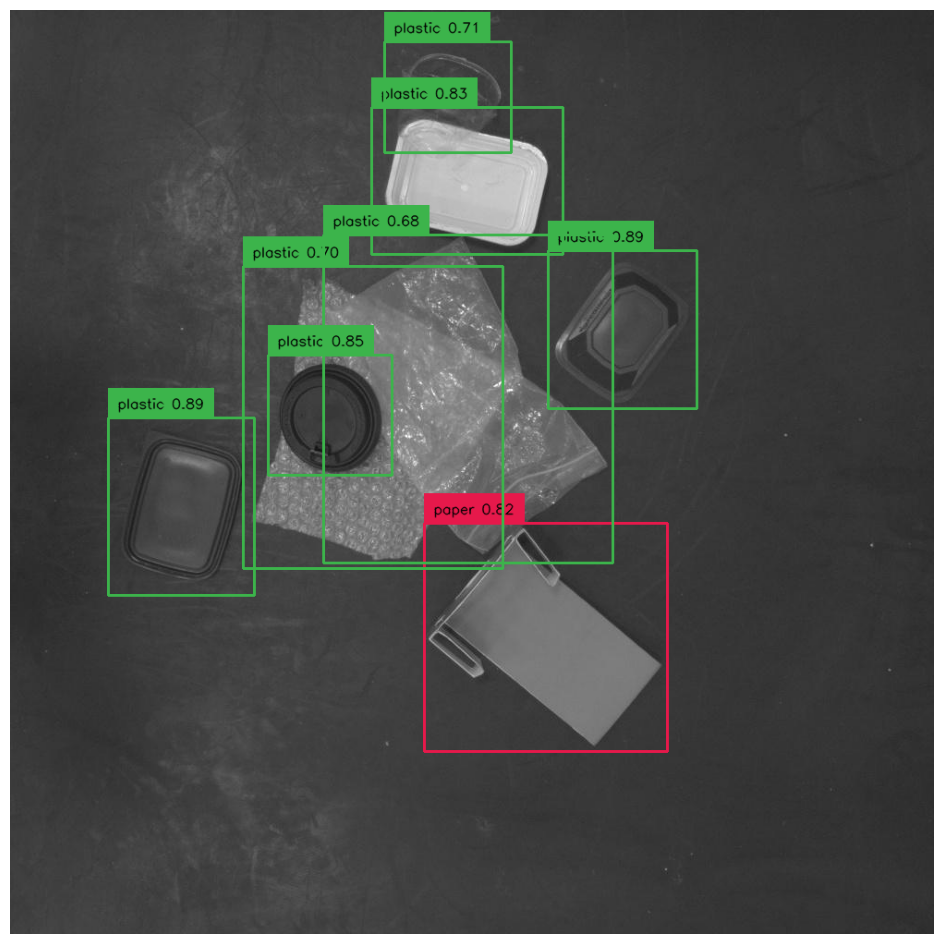

CPU times: user 1.1 s, sys: 70.9 ms, total: 1.17 s
Wall time: 1.28 s


In [85]:
%%time

import supervision as sv
import cv2

SOURCE_IMAGE_PATH = f"{HOME}/test/images/191_jpg.rf.4e7aead6dce85b46b3be5a2adc074fb9.jpg"
CONFIDENCE_TRESHOLD = 0.5

image = cv2.imread(SOURCE_IMAGE_PATH)
result = list(best_model.predict(image, conf=CONFIDENCE_TRESHOLD))[0]

detections = sv.Detections(
    xyxy=result.prediction.bboxes_xyxy,
    confidence=result.prediction.confidence,
    class_id=result.prediction.labels.astype(int)
)

box_annotator = sv.BoxAnnotator()

labels = [
    f"{result.class_names[class_id]} {confidence:0.2f}"
    for _, _, confidence, class_id, _
    in detections
]

annotated_frame = box_annotator.annotate(
    scene=image.copy(),
    detections=detections,
    labels=labels
)

%matplotlib inline
print('predictions')
#print(time_end=-ime.start)
sv.plot_image(annotated_frame, (12, 12))

In [ ]:
# SOURCE_IMAGE_PATH = f"{HOME}/test/images/191_jpg.rf.4e7aead6dce85b46b3be5a2adc074fb9.jpg"
# CONFIDENCE_TRESHOLD = 0.5

# image = cv2.imread(SOURCE_IMAGE_PATH)
# result = list(best_model.predict(image, conf=CONFIDENCE_TRESHOLD))[0]

# box_annotator = sv.BoxAnnotator()

# detections = sv.Detections.from_coco_annotations(coco_annotation=annotations)
# labels = [f'{id2label[class_id]}' for _,_, class_id, _ in detections]
# frame = box_annotator.annotate(scene=image.copy(),
#                                detections=detections,
#                                labels=labels)


# frame_with_annotations = box_annotator.annotate(
#     scene=image.copy(),
#     detections=ds.annotations[key],
#     skip_label=True
# )
# images.append(frame_with_annotations)
# titles.append('annotations')

In [64]:
# import supervision as sv

# ds = sv.DetectionDataset.from_yolo(
#     images_directory_path='content/test/images',
#     annotations_directory_path='content/test/labels',
#     data_yaml_path='./data.yaml',
#     force_masks=False
# )


In [44]:
# import supervision as sv

# CONFIDENCE_TRESHOLD = 0.5

# predictions = {}

# for image_name, image in ds.images.items():
#   result = list(best_model.predict(image, conf=CONFIDENCE_TRESHOLD))[0]
#   detections = sv.Detections(
#         xyxy=result.prediction.bboxes_xyxy,
#         confidence=result.prediction.confidence,
#         class_id=result.prediction.labels.astype(int)
#     )
#   predictions[image_name] = detections

In [69]:
# ds

DetectionDataset(classes=[], images={}, annotations={})

In [56]:
# ds.images.items()

dict_items([])

### Visualize inference results

In [39]:
# import random
# random.seed(10)

In [41]:
# import supervision as sv

# MAX_IMAGE_COUNT = 5

# n = min(MAX_IMAGE_COUNT, len(ds.images))
# print(n)

# # keys = list(ds.images.keys())
# # keys = random.sample(keys, n)

# # box_annotator = sv.BoxAnnotator()

# # images = []
# # titles = []

# # for key in keys:
# #     frame_with_annotations = box_annotator.annotate(
# #         scene=ds.images[key].copy(),
# #         detections=ds.annotations[key],
# #         skip_label=True
# #     )
# #     images.append(frame_with_annotations)
# #     titles.append('annotations')
# #     frame_with_predictions = box_annotator.annotate(
# #         scene=ds.images[key].copy(),
# #         detections=predictions[key],
# #         skip_label=True
# #     )
# #     images.append(frame_with_predictions)
# #     titles.append('predictions')

# # %matplotlib inline
# # sv.plot_images_grid(images=images, titles=titles, grid_size=(n, 2), size=(2 * 4, n * 4))

0


Не работает поэтому заново загружу датасет через утилиту

In [76]:
%cd {HOME}

import roboflow
from roboflow import Roboflow

rf = Roboflow(api_key="dpA5aKicaVcz8fDw1Yag")
project = rf.workspace("space-ibfuh").project("trash-detection-rofav")
dataset = project.version(1).download("yolov5")

/content
loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to Trash-Detection-1 in yolov5pytorch:: 100%|██████████| 506/506 [00:00<00:00, 6314.41it/s]


In [77]:
LOCATION = dataset.location
print("location:", LOCATION)
CLASSES = sorted(project.classes.keys())
print("classes:", CLASSES)

location: /content/Trash-Detection-1
classes: ['paper', 'plastic']


In [78]:
MODEL_ARCH = 'yolo_nas_l'
BATCH_SIZE = 8
MAX_EPOCHS = 25
CHECKPOINT_DIR = f'{HOME}/checkpoints'
EXPERIMENT_NAME = project.name.lower().replace(" ", "_")

In [79]:
import supervision as sv

ds = sv.DetectionDataset.from_yolo(
    images_directory_path=f"{dataset.location}/test/images",
    annotations_directory_path=f"{dataset.location}/test/labels",
    data_yaml_path=f"{dataset.location}/data.yaml",
    force_masks=False
)

In [81]:
import supervision as sv

CONFIDENCE_TRESHOLD = 0.5

predictions = {}

for image_name, image in ds.images.items():
    result = list(best_model.predict(image, conf=CONFIDENCE_TRESHOLD))[0]
    detections = sv.Detections(
        xyxy=result.prediction.bboxes_xyxy,
        confidence=result.prediction.confidence,
        class_id=result.prediction.labels.astype(int)
    )
    predictions[image_name] = detections

In [82]:
import random
random.seed(10)

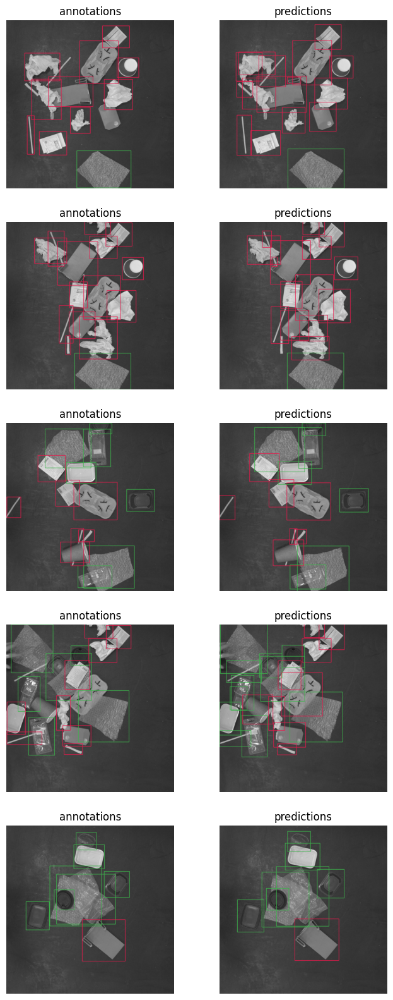

In [83]:
import supervision as sv

MAX_IMAGE_COUNT = 5

n = min(MAX_IMAGE_COUNT, len(ds.images))

keys = list(ds.images.keys())
keys = random.sample(keys, n)

box_annotator = sv.BoxAnnotator()

images = []
titles = []

for key in keys:
    frame_with_annotations = box_annotator.annotate(
        scene=ds.images[key].copy(),
        detections=ds.annotations[key],
        skip_label=True
    )
    images.append(frame_with_annotations)
    titles.append('annotations')
    frame_with_predictions = box_annotator.annotate(
        scene=ds.images[key].copy(),
        detections=predictions[key],
        skip_label=True
    )
    images.append(frame_with_predictions)
    titles.append('predictions')

%matplotlib inline
sv.plot_images_grid(images=images, titles=titles, grid_size=(n, 2), size=(2 * 4, n * 4))

### Calculate confusion matrix

In [1]:
!pip install onemetric

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 kB 7.4 MB/s eta 0:00:00


In [5]:
# !zip -r /content/checkpoints.zip /content/checkpoints

  adding: content/checkpoints/ (stored 0%)
  adding: content/checkpoints/Trash detection yolo-nas/ (stored 0%)
  adding: content/checkpoints/Trash detection yolo-nas/events.out.tfevents.1684938902.1fd1c7b6972e.7767.1 (deflated 42%)
  adding: content/checkpoints/Trash detection yolo-nas/experiment_logs_May24_13_58_05.txt (deflated 74%)
  adding: content/checkpoints/Trash detection yolo-nas/average_model.pth (deflated 8%)
  adding: content/checkpoints/Trash detection yolo-nas/console_May24_13_58_05.txt (deflated 93%)
  adding: content/checkpoints/Trash detection yolo-nas/ckpt_latest.pth (deflated 8%)
  adding: content/checkpoints/Trash detection yolo-nas/events.out.tfevents.1684936685.1fd1c7b6972e.7767.0 (deflated 82%)
  adding: content/checkpoints/Trash detection yolo-nas/logs_May24_13_58_05.txt (deflated 92%)
  adding: content/checkpoints/Trash detection yolo-nas/ckpt_best.pth (deflated 8%)


In [ ]:
# from google.colab import files
# files.download("/content/checkpoints.zip")

In [2]:
import os

import numpy as np

from onemetric.cv.object_detection import ConfusionMatrix

keys = list(ds.images.keys())

annotation_batches, prediction_batches = [], []

for key in keys:
    annotation=ds.annotations[key]
    annotation_batch = np.column_stack((
        annotation.xyxy, 
        annotation.class_id
    ))
    annotation_batches.append(annotation_batch)

    prediction=predictions[key]
    prediction_batch = np.column_stack((
        prediction.xyxy, 
        prediction.class_id,
        prediction.confidence
    ))
    prediction_batches.append(prediction_batch)

confusion_matrix = ConfusionMatrix.from_detections(
    true_batches=annotation_batches, 
    detection_batches=prediction_batches,
    num_classes=len(ds.classes),
    conf_threshold=CONFIDENCE_TRESHOLD
)

confusion_matrix.plot(os.path.join(HOME, "confusion_matrix.png"), class_names=ds.classes)

NameError: ignored